In [74]:
import autosklearn.regression
import sklearn.metrics
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from tqdm import tqdm
%matplotlib inline
init_notebook_mode(connected=True)

In [2]:
config = {
    "gap_scenario": '15min', # '1h', '1min', '15min',
    "random_seed": 21321,
    "train_set_ratio": 0.8,
    "window_size": 10 # number of previosu values chosen for prediction
}

# Import Energy dataset

In [29]:
energy_path = "res/energy/iiitd/Academic Block/Building Total Mains/0/Power.csv"
df_energy = pd.read_csv(energy_path, header=None, names=['timestamp', 'consumption'])
df_energy['date'] = pd.to_datetime(df_energy['timestamp'], unit='ms')
df_energy = df_energy[df_energy["consumption"] > 0].reset_index(drop=True) # filter out corrupt values
df_energy.head(2)

,timestamp,consumption,date
0,1.401696e+12,40767.359375,2014-06-02 07:56:23
1,1.401696e+12,41936.476562,2014-06-02 07:56:53


In [30]:
#iplot([go.Scatter(x=df_energy['date'], y=df_energy['consumption'])])

In [31]:
# calculate median amount of values per interval
df_energy.set_index('date').resample('15min').count().median()

timestamp      30.0
consumption    30.0
dtype: float64

In [32]:
gap_length = 1
# assign mean gap length per time unit
if config["gap_scenario"] == '1d':
    gap_length = 2874
elif config["gap_scenario"] == '1h':
    gap_length = 120
elif config["gap_scenario"] == '15min':
    gap_length = 30
elif config["gap_scenario"] == '1min':
    gap_length = 2
    
print(f"Scenario {config['gap_scenario']}: using gap length of {gap_length}")

Scenario 15min: using gap length of 30


### Train/Test Splits
define random cut points within interval [gap_length, value_count]

In [33]:
# fix seed
np.random.seed(config["random_seed"])
cut_start = gap_length + np.random.randint(0,gap_length)
max_idx = df_energy.shape[0]
cut_points = [x for x in range(cut_start, max_idx, gap_length)]
np.random.shuffle(cut_points)

train_test_split_p = int(len(cut_points) * config["train_set_ratio"])
train_start_idx = cut_points[:train_test_split_p]
test_start_idx = cut_points[train_test_split_p:]
train_ids = np.concatenate([np.arange(start_idx, np.min([start_idx + gap_length, max_idx])) for start_idx in train_start_idx] +
                          [np.arange(0, cut_start)])
test_ids = np.concatenate([np.arange(start_idx, np.min([start_idx + gap_length, max_idx])) for start_idx in test_start_idx])
df_train_v = df_energy.copy()
df_train_v.loc[test_ids,'date'] = np.NaN
df_test_v = df_energy.copy()
df_test_v.loc[train_ids,'date'] = np.NaN

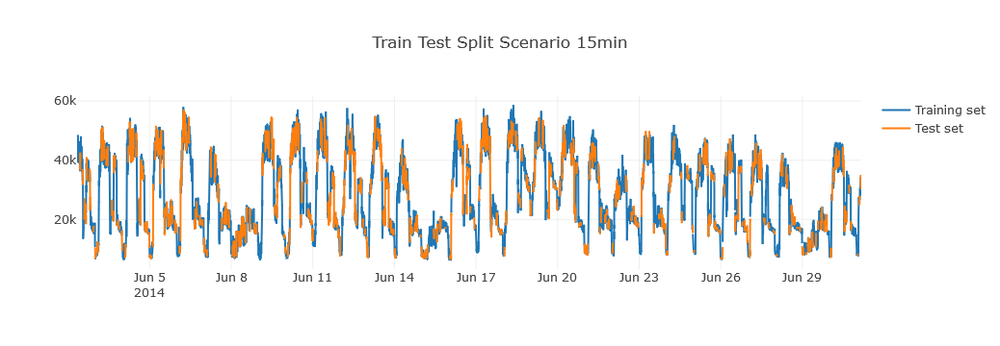

In [34]:
iplot(
    go.Figure(
        data = [go.Scatter(x=df_train_v['date'], y=df_train_v['consumption'], name='Training set'),
                go.Scatter(x=df_test_v['date'], y=df_test_v['consumption'], name='Test set')],
        layout = go.Layout(
            title = f"Train Test Split Scenario {config['gap_scenario']}")
        ))

### Transform to ML useable data

In [35]:
def get_ml_format_df(window_size=config["window_size"]):
    df_energy_ml = df_energy.drop(["timestamp", "date"], axis=1)
    for i in range(1, window_size+1):
        df_energy_ml[f"prev_{i}"] = df_energy_ml["consumption"].shift(i)

    df_energy_ml = df_energy_ml.dropna() # do not use the first <window_size> entries for training
    return df_energy_ml
train_ids = train_ids[train_ids > config["window_size"]]
df_energy_ml = get_ml_format_df()
df_energy_ml.head(5)

,consumption,prev_1,prev_2,prev_3,prev_4,prev_5,prev_6,prev_7,prev_8,prev_9,prev_10
10,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562,41936.476562,40767.359375
11,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562,41936.476562
12,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562
13,41225.296875,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250
14,44635.769531,41225.296875,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000


In [117]:
df_train = df_energy_ml.loc[train_ids,]
df_test = df_energy_ml.loc[test_ids,]
print(f"Effective train/test ratio is {np.round(df_train.shape[0]/(df_train.shape[0]+df_test.shape[0]), 2)}")

x_train = df_train.drop("consumption", axis=1)
Y_train = df_train["consumption"]
x_test = df_test.drop("consumption", axis=1)
Y_test = df_test["consumption"]

Effective train/test ratio is 0.8






52it [00:20, 15.94it/s]

### Utils

In [41]:
from sklearn.metrics import mean_squared_error

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / (y_true))) * 100

### Train our classifier

In [38]:
np.random.seed(config["random_seed"]) # seed again for multiple executions within notebook
feature_types = ["Numerical" for x in x_train.columns]
automl = autosklearn.regression.AutoSklearnRegressor(
        time_left_for_this_task=600,
        per_run_time_limit=60
    )
automl.fit(x_train, Y_train, dataset_name="Power", feat_type=feature_types)

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice



[WARNING] [2019-05-28 19:07:08,384:AutoMLSMBO(1)::Power] Could not find meta-data directory /usr/local/lib/python3.6/dist-packages/autosklearn/metalearning/files/r2_regression_dense
[WARNING] [2019-05-28 19:07:08,420:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:08,437:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:10,449:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:12,456:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:14,465:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:16,470:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:18,475:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-28 19:07:20,483:Ensemb

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice



[WARNING] [2019-05-28 19:08:02,637:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!


/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice



[WARNING] [2019-05-28 19:08:04,641:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!


/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/loc

AutoSklearnRegressor(delete_output_folder_after_terminate=True,
           delete_tmp_folder_after_terminate=True,
           disable_evaluator_output=False, ensemble_memory_limit=1024,
           ensemble_nbest=50, ensemble_size=50, exclude_estimators=None,
           exclude_preprocessors=None, get_smac_object_callback=None,
           include_estimators=None, include_preprocessors=None,
           initial_configurations_via_metalearning=25, logging_config=None,
           ml_memory_limit=3072, output_folder=None, per_run_time_limit=60,
           resampling_strategy='holdout',
           resampling_strategy_arguments=None, seed=1, shared_mode=False,
           smac_scenario_args=None, time_left_for_this_task=600,
           tmp_folder=None)

In [42]:
predictions = automl.predict(x_test)
print("MAPE score:", mean_absolute_percentage_error(Y_test, predictions))
print("MSE score:", mean_squared_error(Y_test, predictions))
print("RMSE score:", mean_squared_error(Y_test, predictions) ** 0.5)

MAPE score: 2.9851084879833234
MSE score: 1596189.9477028695
RMSE score: 1263.4041110044202


In [43]:
# baselines
# always mean
print("Baselines...")
print("Always mean, MAPE score:", mean_absolute_percentage_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])))
print("Always mean, MSE score:", mean_squared_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])))
print("Always mean, RMSE score:", mean_squared_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])) ** 0.5)
print("Always median, MAPE score:", mean_absolute_percentage_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])))
print("Always median, MSE score:", mean_squared_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])))
print("Always median, RMSE score:", mean_squared_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])) ** 0.5)
print("Always previous, MAPE score:", mean_absolute_percentage_error(Y_test, np.nan_to_num(Y_test.shift(1))))
print("Always previous, MSE score:", mean_squared_error(Y_test, np.nan_to_num(Y_test.shift(1))))
print("Always previous, RMSE score:", mean_squared_error(Y_test, np.nan_to_num(Y_test.shift(1))) ** 0.5)

Baselines...
Always mean, MAPE score: 60.122638256506235
Always mean, MSE score: 161900474.75878564
Always mean, RMSE score: 12724.011739965727
Always median, MAPE score: 52.776622237262984
Always median, MSE score: 173842537.38579974
Always median, RMSE score: 13184.936002339933
Always previous, MAPE score: 5.277241556682503
Always previous, MSE score: 12775518.655079776
Always previous, RMSE score: 3574.285754536111


## Visualize predictions

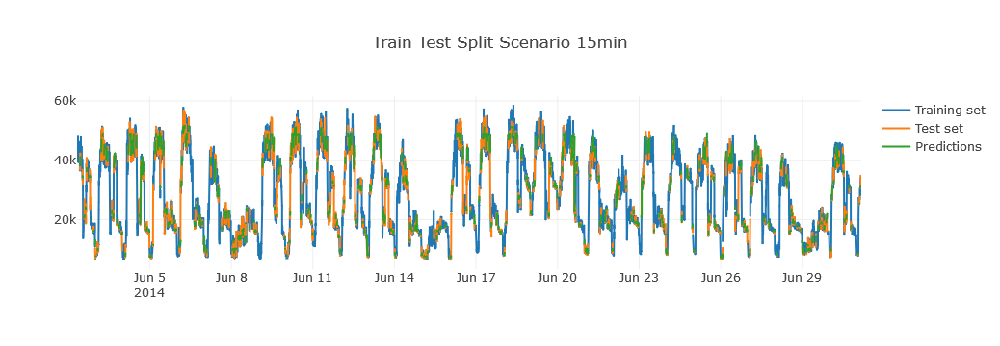

In [123]:
df_test_p = df_test_v.copy()
df_test_p.loc[test_ids,'pred'] = pred_ahead
iplot(
    go.Figure(
        data = [go.Scatter(x=df_train_v['date'], y=df_train_v['consumption'], name='Training set'),
                go.Scatter(x=df_test_v['date'], y=df_test_v['consumption'], name='Test set'),
                go.Scatter(x=df_test_p['date'], y=df_test_p['pred'], name='Predictions')],
        layout = go.Layout(
            title = f"Train Test Split Scenario {config['gap_scenario']}")
        ))

In [ ]:
#automl.cv_results_
#automl.sprint_statistics()
automl.show_models()

In [118]:
def predict_ahead(clf, x_test, window_size):
    """
    recursively predicts time series data based on previous predictions
    does so in batch-wise manner (ie previous predictions are used if x_n.prev_2==x_(n-1).prev_1)
    otherwise values passed via x_test.prev_x are used as input for prediction
    """
    if window_size < 2:
        raise Exception('window size < 2 not supported, predict directly on values')
    Y_pred = []
    cur_y_pred = [] # used to store previous predictions for current batch
    prev_x = 0
    for row in tqdm(x_test.iterrows()):
        if prev_x != row[1]['prev_2']:
            cur_y_pred = [] # detected a new batch, so clear old values
        
        # set previous value for batch detection
        prev_x = np.copy(row[1]["prev_1"])
        
        # fill values for prediction from previous predictions
        for idx, val in enumerate(cur_y_pred[:-window_size-1:-1]):
            row[1][f"prev_{idx+1}"] = val
        
        # predict based on previous predictions (or on values passed from train if no such predictions exist)
        new_pred = clf.predict(np.array(row[1].values).reshape(1, -1))
        Y_pred.append(new_pred)
        cur_y_pred.append(new_pred)
    
    return np.squeeze(Y_pred)

In [120]:
pred_ahead = predict_ahead(automl, x_test, 10)







0it [00:00, ?it/s]





2it [00:00, 10.13it/s]





4it [00:00, 11.41it/s]





5it [00:00, 10.83it/s]





8it [00:00, 13.05it/s]





10it [00:00, 13.97it/s]





12it [00:00, 14.40it/s]





14it [00:00, 14.77it/s]





16it [00:01, 15.06it/s]





18it [00:01, 15.67it/s]





20it [00:01, 16.05it/s]





22it [00:01, 15.21it/s]





24it [00:01, 16.17it/s]





26it [00:01, 15.83it/s]





28it [00:01, 15.90it/s]





30it [00:01, 16.30it/s]





33it [00:02, 17.97it/s]





36it [00:02, 19.89it/s]





39it [00:02, 21.34it/s]





42it [00:02, 19.72it/s]





45it [00:02, 19.10it/s]





47it [00:02, 18.43it/s]





50it [00:02, 19.79it/s]





53it [00:03, 19.66it/s]





56it [00:03, 21.52it/s]





59it [00:03, 22.15it/s]





62it [00:03, 19.38it/s]





65it [00:03, 20.45it/s]





68it [00:03, 19.79it/s]





71it [00:03, 19.05it/s]





73it [00:04, 18.99it/s]





75it [00:04, 19.10it/s]





77it [00:04, 18.83it/s]





79it [00:04, 16.92it/s]





81it [00:04, 14.8

In [121]:
mean_absolute_percentage_error(Y_test, pred_ahead)

7.767149677610945

In [122]:
mean_squared_error(Y_test, pred_ahead) ** 0.5

2976.3227426282183

In [94]:
x_test

,prev_1,prev_2,prev_3,prev_4,prev_5,prev_6,prev_7,prev_8,prev_9,prev_10
60164,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562,45067.402344,40080.050781,43093.726562,40206.968750,40776.769531
60165,41933.375938,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562,45067.402344,40080.050781,43093.726562,40206.968750
60166,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562,45067.402344,40080.050781,43093.726562
60167,41335.328906,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562,45067.402344,40080.050781
60168,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562,45067.402344
60169,42884.314375,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656,40077.605469,40378.101562
60170,42186.550781,42559.835938,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656,40077.605469
60171,42940.686797,42186.550781,42559.835938,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750,42507.628906,43868.347656
60172,40169.632812,44418.640625,42186.550781,42559.835938,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750,42507.628906
60173,41231.791719,40169.632812,44418.640625,42186.550781,42559.835938,42856.972656,44734.582031,40498.488281,40466.968750,42250.718750
